In [1]:
import warnings
from pathlib import Path

import numpy as np
import pytorch_lightning as pl
import torch
from torchvision.utils import make_grid
from matplotlib import pyplot as plt
from pytorch_lightning import loggers as pl_loggers
from pytorch_lightning.callbacks import RichProgressBar, ModelCheckpoint

In [2]:
from zprp.models.cycle_gan.data import CycleGanDataModule
from zprp.models.cycle_gan.model import CycleGAN
from zprp.models.cycle_gan.unet import UNet
from zprp.models.cycle_gan.densenet import BinaryDenseNetClassifier

In [3]:
LOG_PATH = "lightning_logs"
LOG_NAME = "cyclegan_example"
DATA_PATH = Path("../data")

In [4]:
torch.set_float32_matmul_precision("high")
# lightning complaining about using only one worker in DataLoader
warnings.filterwarnings("ignore", ".*does not have many workers.*")

In [5]:
CONTENT_PATH = DATA_PATH / "photo/0"
STYLE_PATH = DATA_PATH / "monet/0"

In [6]:
def unnormalize(x: torch.Tensor) -> torch.Tensor:
    return (x * 0.5) + 0.5

torch.float32


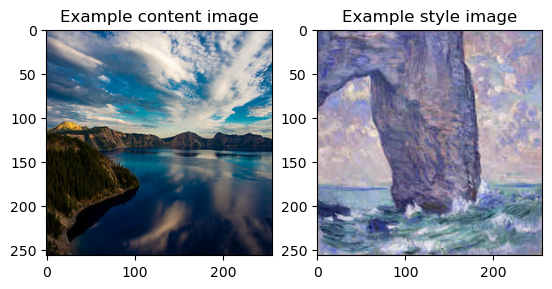

In [7]:
dm = CycleGanDataModule(content_path=CONTENT_PATH, style_path=STYLE_PATH, n_val_images=64, batch_size=4, img_size=256)
dm.setup("fit")

content_img, style_img = next(iter(dm.train_dataloader()))

print(content_img.dtype)

fix, axes = plt.subplots(1, 2)

axes[0].imshow(np.transpose(unnormalize(content_img[0]), axes=(1, 2, 0)))
axes[0].set_title("Example content image")
axes[1].imshow(np.transpose(unnormalize(style_img[0]), axes=(1, 2, 0)))
axes[1].set_title("Example style image")
plt.show()

In [8]:
epochs = 200
tb_logger = pl_loggers.TensorBoardLogger(save_dir=LOG_PATH, name=LOG_NAME)

model = CycleGAN(
    # GeneratorClass=UNet3,  # other options
    # DiscriminatorClass=BinaryDenseNetClassifier,
    lambda_param=1.)

periodic_callback = ModelCheckpoint(
    save_top_k=-1,
    every_n_epochs=1,
    filename="checkpoint_periodic-{epoch:04d}",
)

trainer = pl.Trainer(
    max_epochs=epochs,
    logger=tb_logger,
    log_every_n_steps=1,
    callbacks=[
        RichProgressBar(refresh_rate=1),
        periodic_callback,
    ],
)
trainer.fit(model, dm)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃   ┃ Name                   ┃ Type                 ┃ Params ┃
┡━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│ 0 │ g                      │ Generator            │ 11.4 M │
│ 1 │ f                      │ Generator            │ 11.4 M │
│ 2 │ dx                     │ Discriminator        │  2.8 M │
│ 3 │ dy                     │ Discriminator        │  2.8 M │
│ 4 │ lsgan_loss             │ LSGANLoss            │      0 │
│ 5 │ cycle_consistency_loss │ CycleConsistencyLoss │      0 │
└───┴────────────────────────┴──────────────────────┴────────┘

Trainable params: 28.3 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 28.3 M                                                                                               
Total estimated model params size (MB): 113

Output()

/home/tomek/miniconda3/envs/zprp/lib/python3.11/site-packages/pytorch_lightning/trainer/call.py:54: Detected 
KeyboardInterrupt, attempting graceful shutdown...

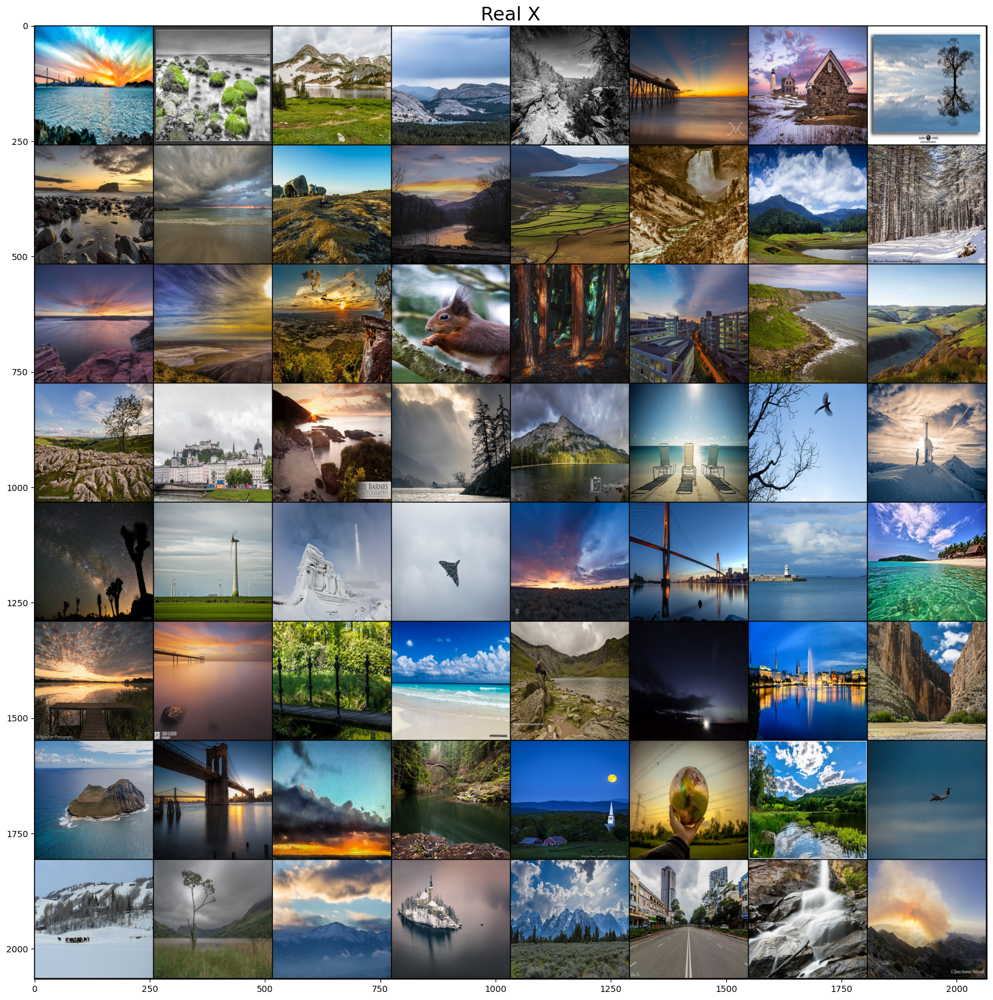

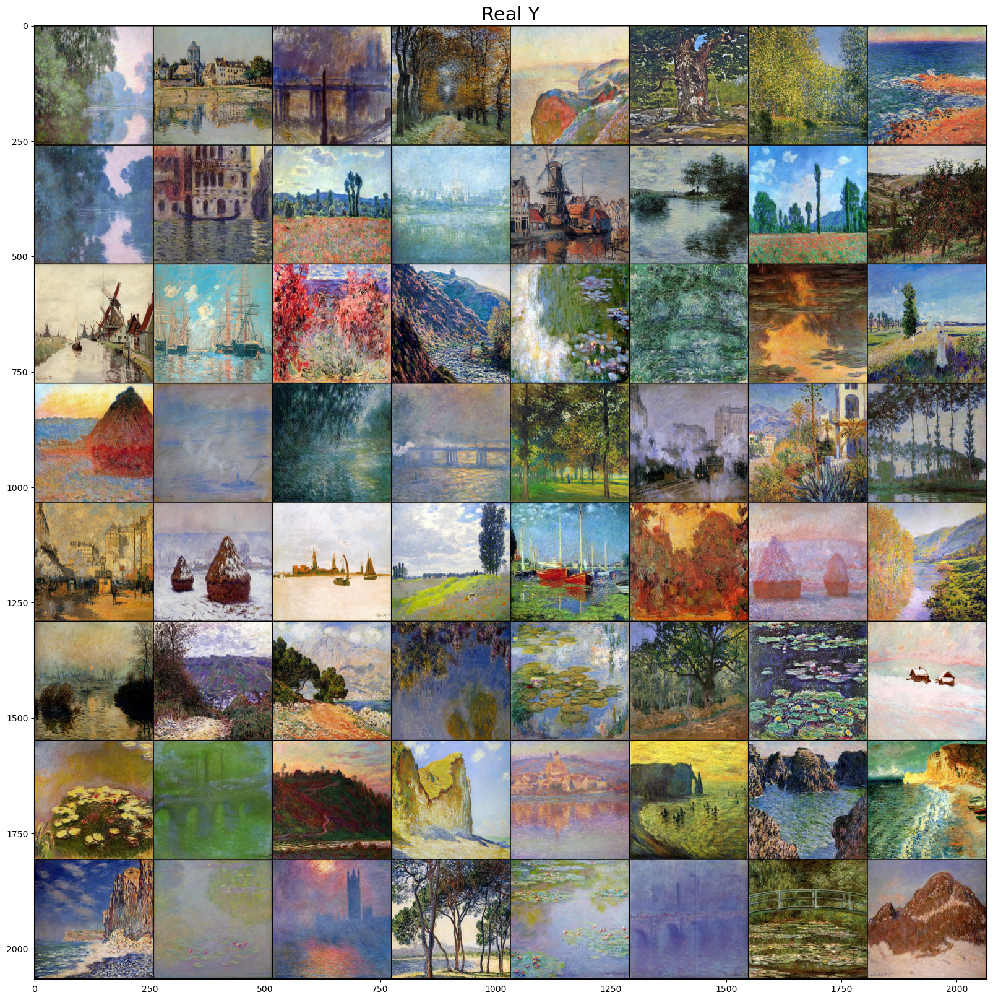

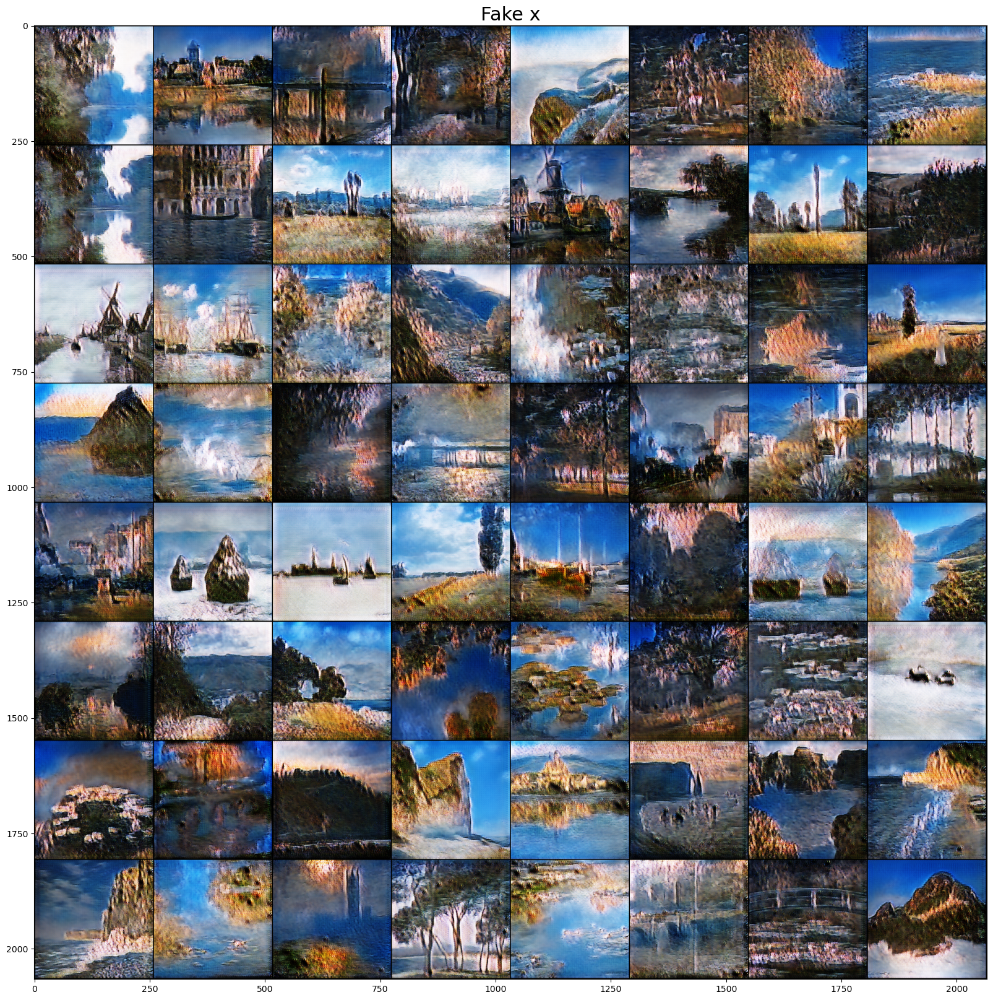

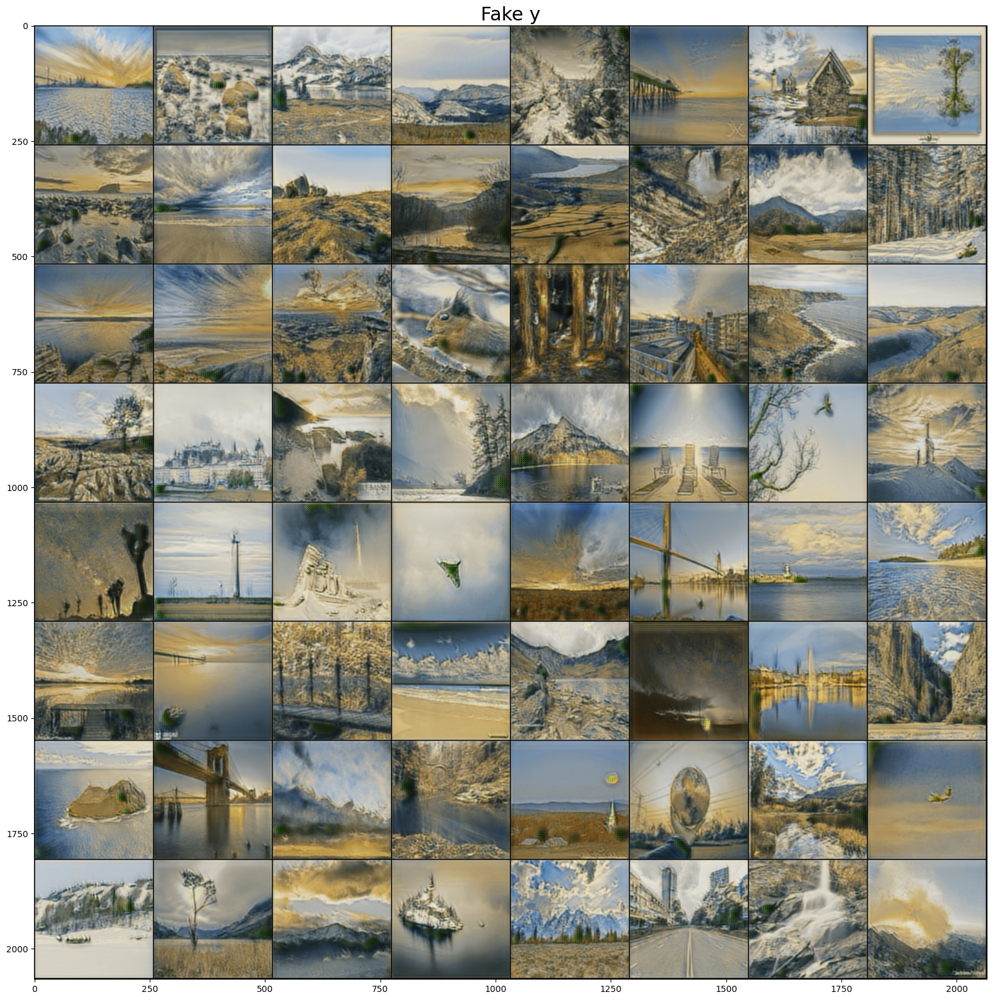

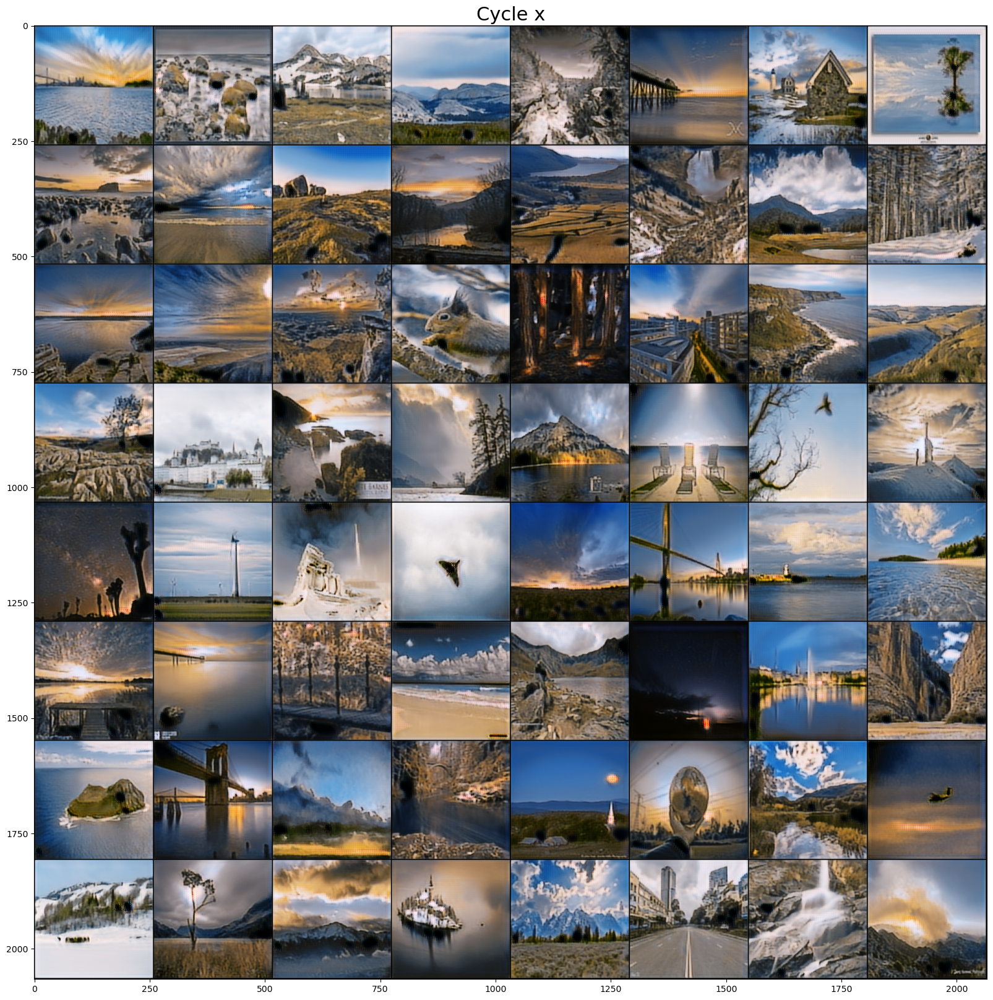

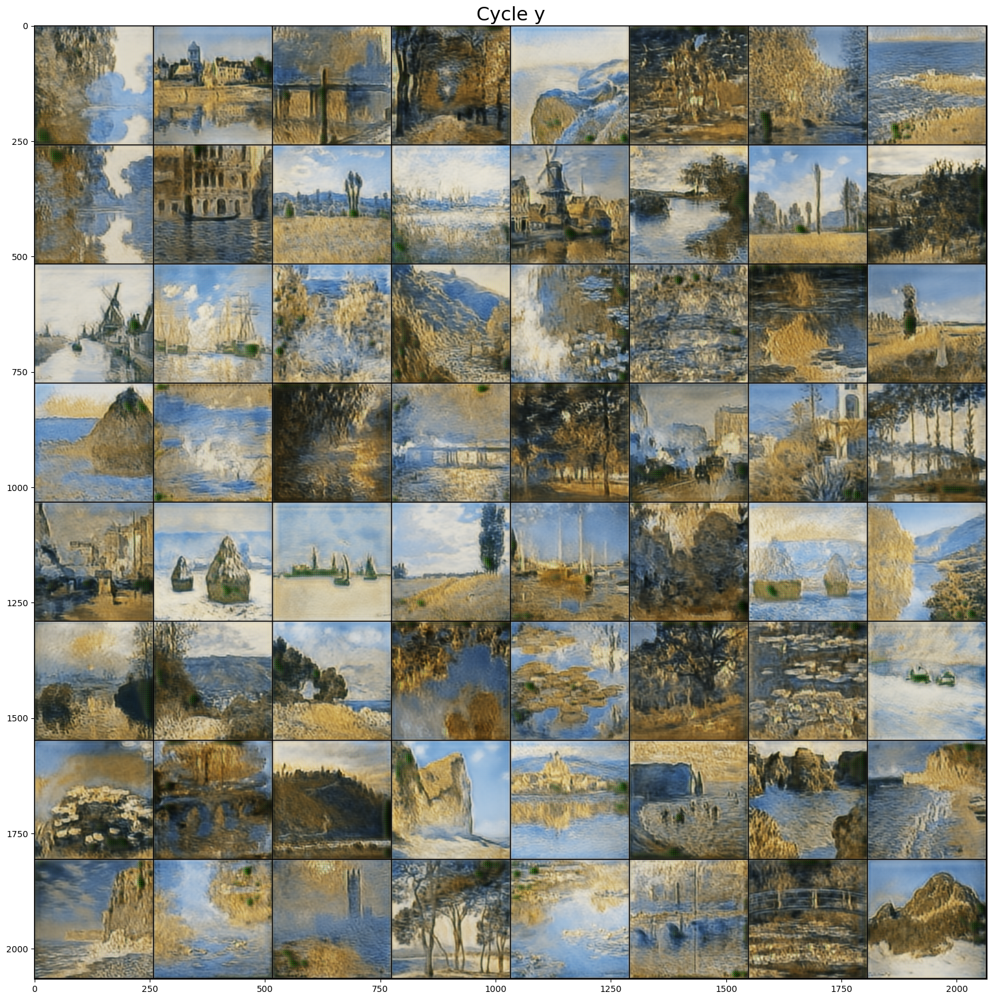

In [9]:
# CHECKPOINT: str | None = "lightning_logs/cyclegan_example/version_6/checkpoints/checkpoint_periodic-epoch=0033.ckpt"
CHECKPOINT: str | None  = None

if CHECKPOINT:
    model = CycleGAN.load_from_checkpoint(CHECKPOINT)


device = torch.device("cuda") if torch.cuda.is_available else torch.device("cpu")

model.eval()
model.g.eval()
model.f.eval()

images_x, images_y = next(iter(dm.val_dataloader()))
images_x = images_x.to(device)
images_y = images_y.to(device)

with torch.no_grad():
    fake_y = model.x_to_y(images_x)
    cycle_x = model.y_to_x(fake_y)
    fake_x = model.y_to_x(images_y)
    cycle_y = model.x_to_y(fake_x)

def show_img(img, title):
    plt.imshow(make_grid(unnormalize(img)).permute(1, 2, 0).cpu())
    if title:
        plt.title(title, size=22)
    plt.show()

plt.rcParams["figure.figsize"] = (20,20)

show_img(images_x, "Real X")
show_img(images_y, "Real Y")
show_img(fake_x, "Fake x")
show_img(fake_y, "Fake y")
show_img(cycle_x, "Cycle x")
show_img(cycle_y, "Cycle y")
